In [1]:
! pip install contractions

# Libraries

In [2]:
import numpy as np
import random
import requests
import re
import itertools
from tqdm import tqdm

In [3]:
url="https://ocw.mit.edu/ans7870/6/6.006/s08/lecturenotes/files/t8.shakespeare.txt"
response = requests.get(url)
if (response.status_code):
    data = response.text

In [4]:
text = data

# Preprocessing

### downloading stopwords

In [ ]:
! wget https://gist.githubusercontent.com/ZohebAbai/513218c3468130eacff6481f424e4e64/raw/b70776f341a148293ff277afa0d0302c8c38f7e2/gist_stopwords.txt

gist_file = open("gist_stopwords.txt", "r")
try:
    content = gist_file.read()
    stopwords = content.split(",")
finally:
    gist_file.close()

### deleting unnecessary subtexts from text

In [ ]:
idx = text.find("by William Shakespeare")
text = text[idx:]

pattern = '<<(.|\s)+?>>'
text = re.sub(pattern, "", text)

### preprocessing function

In [ ]:

import re
import string
from unicodedata import normalize

# Third party libraries
import contractions
import nltk
from nltk.tokenize import word_tokenize

def preprocessing(input_text: str):
    # Convert input text to lower case
    text = input_text.lower()
    
    # Expand contractions in input text
    text = contractions.fix(text)

    # Removes all punctuations from a string
    punctuations = string.punctuation
    text = text.translate(str.maketrans('', '', punctuations))

    # Remove number in the input text
    text = re.sub('\d+', '', text)
    
    # Removes leading, trailing, and (optionally) duplicated whitespace
    text = re.sub('\s+', ' ', text, flags=re.UNICODE)
    text = text.strip()
    
    '''
    # Normalize unicode data to remove umlauts, and accents, etc.
    processed_tokens = normalize('NFKD', processed_text).encode('ASCII', 'ignore').decode('utf8')
    processed_text = ' '.join(processed_tokens)
    '''

    # Remove stop words
    pattern = re.compile(r'[A-Za-z]+[\w^\']*|[\w^\']*[A-Za-z]+[\w^\']*')
    tokens = pattern.findall(text)
    tokens = [token for token in tokens if token not in stopwords]

    
    return ' '.join(tokens)
    

In [ ]:
p_text = preprocessing(text).split()

# Model

In [6]:
class SkipGram:
    
    def __init__(self, corpus, embedding_size=100, window_size=2, num_ns=4, folded = False):
        self.folded = folded
        self.corpus = corpus
        if self.folded:
            self.folded_corpus = corpus
            self.corpus = list(itertools.chain.from_iterable(corpus))

        self.embedding_size = embedding_size
        self.window_size = window_size
        self.num_ns = num_ns
        self.vocab_size = len(set(self.corpus))
        self.word2index = {w: i for i, w in enumerate(set(self.corpus))}
        self.index2word = {i: w for w, i in self.word2index.items()}
        self.initialize_weights()
        self.targets = []
        self.contexts = []
        self.create_training_data()
        
        
    def initialize_weights(self):
        self.W1 = np.random.uniform(-0.8, 0.8, (self.vocab_size, self.embedding_size))
        self.W2 = np.random.uniform(-0.8, 0.8, (self.embedding_size, self.vocab_size))


    def create_training_data(self):
        if self.folded:
            for c in tqdm(self.folded_corpus):
                targets, contexts = self.sub_create_training_data(c)
                self.targets.append(targets)
                self.contexts.append(contexts)
        else:
            self.targets, self.contexts = self.sub_create_training_data(self.corpus)


    def sub_create_training_data(self, corpus):
        targets = []
        contexts = []
        for j, center_word in enumerate(corpus):
            context_words = self.get_context_words(j, corpus)
            center_word = self.word2index[center_word]
            for context_word in context_words:
                negative_samples = self.get_negative_samples(context_words)
                targets.append(center_word)
                contexts.append(np.array(list([context_word])+list(negative_samples)))
        return targets, contexts

    def sub_train(self,targets,contexts):
        history = []
        loss = []
        for j, target in enumerate(targets): 
            context_word = contexts[j][0]
            negative_samples = contexts[j][1:]
            error, x_grad, pos_grad, neg_grad = self.calculate_gradients(target, context_word, negative_samples)
            self.W1[target] -= self.learning_rate * x_grad
            self.W2[:, context_word] -= self.learning_rate * pos_grad
            self.W2[:, negative_samples] -= self.learning_rate * neg_grad.T
            loss.append(error)
        history.append(np.mean(loss))
        
        return history

    def train(self, epochs, learning_rate=0.01, fold_num=None):
        self.learning_rate = learning_rate
        history = []
        for i in range(epochs):
            if self.folded and fold_num==None:
                his = []
                for i, f_c in enumerate(self.folded_corpus):
                    h = self.sub_train(self.targets[i],self.contexts[i])
                    # self.targets[i],self.contexts[i] = self.create_training_data(f_c)
                    his = his + h
            elif self.folded:
                his = self.sub_train(self.targets[fold_num],self.contexts[fold_num])
                # self.targets[fold_num],self.contexts[fold_num] = self.create_training_data(self.folded_corpus[fold_num])
                his = [his]
            else:
                his = self.sub_train(self.targets,self.contexts)
                self.targets, self.contexts = self.sub_create_training_data(self.corpus)
                his = [his]

            print(f"Epoch: {i}, Loss: {np.mean(his)}")
            history.append(np.mean(his))
        return history
        

    def get_context_words(self, index, corpus):
        context_words = []
        for i in range(max(0, index - self.window_size), min(len(corpus), index + self.window_size + 1)):
            if i != index:
                context_words.append(self.word2index[corpus[i]])
        return context_words
    
    def get_negative_samples(self, context_words):
        negative_samples = []
        while len(negative_samples) < self.num_ns:
            indices = np.random.choice(self.vocab_size, size=self.num_ns, replace=False)
            for sample in indices:
                if sample not in context_words and sample not in negative_samples:
                    negative_samples.append(sample)
                    if len(negative_samples) >= self.num_ns:
                        break
        return negative_samples
    
    def calculate_gradients(self, center_word, context_word, negative_samples):
        x = self.W1[center_word]
        y = self.W2[:, context_word]
        neg_y = self.W2[:, negative_samples]

        pos_error = np.dot(y.T, x)
        neg_error = np.dot(neg_y.T, x)
        error = -np.log(sigmoid(pos_error)) - np.sum(np.log(sigmoid(-neg_error)))

        pos_grad = (sigmoid(pos_error) - 1)*x
        neg_grad = np.outer(sigmoid(neg_error),x)

        expanded_neg_error = np.array([neg_error]*self.embedding_size)
        x_grad = (sigmoid(pos_error) - 1)*y + np.sum((sigmoid(expanded_neg_error))*neg_y, axis=1)

        return error, x_grad, pos_grad,neg_grad
    
    def get_word_vector(self, word):
        index = self.word2index[word]
        return self.W1[index]
    
def sigmoid(x):
    return 1 / (1 + np.exp(-x))


In [7]:
model = SkipGram(p_text)

## learning

In [8]:
history = []

In [9]:

x = model.train(epochs=10, learning_rate=0.1)
history = history + x


Epoch: 0, Loss: 1.9611044840819756
Epoch: 1, Loss: 1.2563125879278658
Epoch: 2, Loss: 1.1051380441080076
Epoch: 3, Loss: 1.0169249505057827
Epoch: 4, Loss: 0.9599954121430709
Epoch: 5, Loss: 0.921354658249057
Epoch: 6, Loss: 0.8951912955141094
Epoch: 7, Loss: 0.8794157789318793
Epoch: 8, Loss: 0.8670596368530066
Epoch: 9, Loss: 0.8572841843947028


In [15]:
x = model.train(epochs=3, learning_rate=0.1)
history = history + x

Epoch: 0, Loss: 0.8516075697781942
Epoch: 1, Loss: 0.8481525396303953
Epoch: 2, Loss: 0.8429368724073987


In [19]:
x = model.train(epochs=5, learning_rate=0.01)
history = history + x

Epoch: 0, Loss: 0.8663229392088385
Epoch: 1, Loss: 0.7343289753011815
Epoch: 2, Loss: 0.6951545663840697
Epoch: 3, Loss: 0.6704931855653093
Epoch: 4, Loss: 0.6535154066341583


In [25]:
x = model.train(epochs=3, learning_rate=0.01)
history = history + x

Epoch: 0, Loss: 0.6405766943467411
Epoch: 1, Loss: 0.6328136832666891
Epoch: 2, Loss: 0.6252191834237113


In [28]:
x = model.train(epochs=6, learning_rate=0.001)
history = history + x

Epoch: 0, Loss: 0.6484115666893856
Epoch: 1, Loss: 0.633236578935113
Epoch: 2, Loss: 0.6279752296895209
Epoch: 3, Loss: 0.6250985420148081
Epoch: 4, Loss: 0.6234511646587291
Epoch: 5, Loss: 0.6217948980293598


/var/folders/tp/2wmvhtmd6xn3g9sxr9y62ytr0000gn/T/ipykernel_11408/3360516422.py:4: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


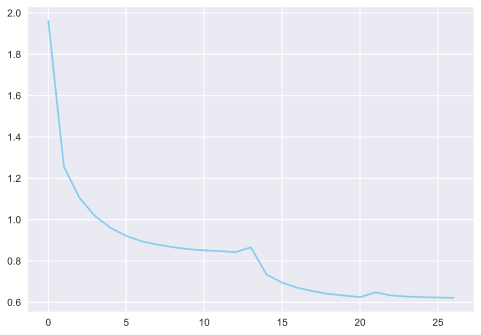

In [30]:

import matplotlib.pyplot as plt

%matplotlib inline
%config InlineBackend.figure_format = 'svg'
plt.style.use("seaborn")

plt.plot(range(len(history)), history, color="skyblue")
plt.show();

### adding the matrixes of Embedding and Context to build final model

In [31]:
W1 = np.array([np.array(row) for row in model.W1])
W2 = np.array([np.array(row) for row in model.W2]).T
final_model = W1 + W2

# PCA

In [32]:

from sklearn.decomposition import PCA

# intialize pca and logistic regression model
pca = PCA(n_components=2)
# fit and transform data
final_model_pca = pca.fit_transform(final_model)

# Visualize Data

In [33]:
a = [
final_model_pca[model.word2index['queen'] - model.word2index['woman']],    # black
final_model_pca[model.word2index['king'] - model.word2index['man']],       # blue
final_model_pca[model.word2index['brother'] - model.word2index['sister']], # red
final_model_pca[model.word2index['uncle'] - model.word2index['aunt']]      # orange
]
a = np.array(a)

In [34]:

s = [5 for _ in range(len(final_model_pca[:, 0]))]
plt.scatter(final_model_pca[:, 0], 
                final_model_pca[:, 1] , alpha=0.5,s=s, )


s = [10 for _ in range(4)]
c= ['black','blue','red','orange']

plt.scatter(a[:, 0], 
                a[:, 1] ,s=s, c=c)